<a href="https://colab.research.google.com/github/prabhu-055/Open_Cv/blob/main/Open_Cv.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**OpenCV Basics**

*   Read and display an image
*   Convert to grayscale
*   Resize the image
*   Draw shapes (rectangle, text)
*   Save the modified image

In [2]:
# Step I: Import required libraries
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow # for image display in Colab

# Step 2: Upload image
from google.colab import files
uploaded = files.upload( )

Saving pg.jpg to pg.jpg


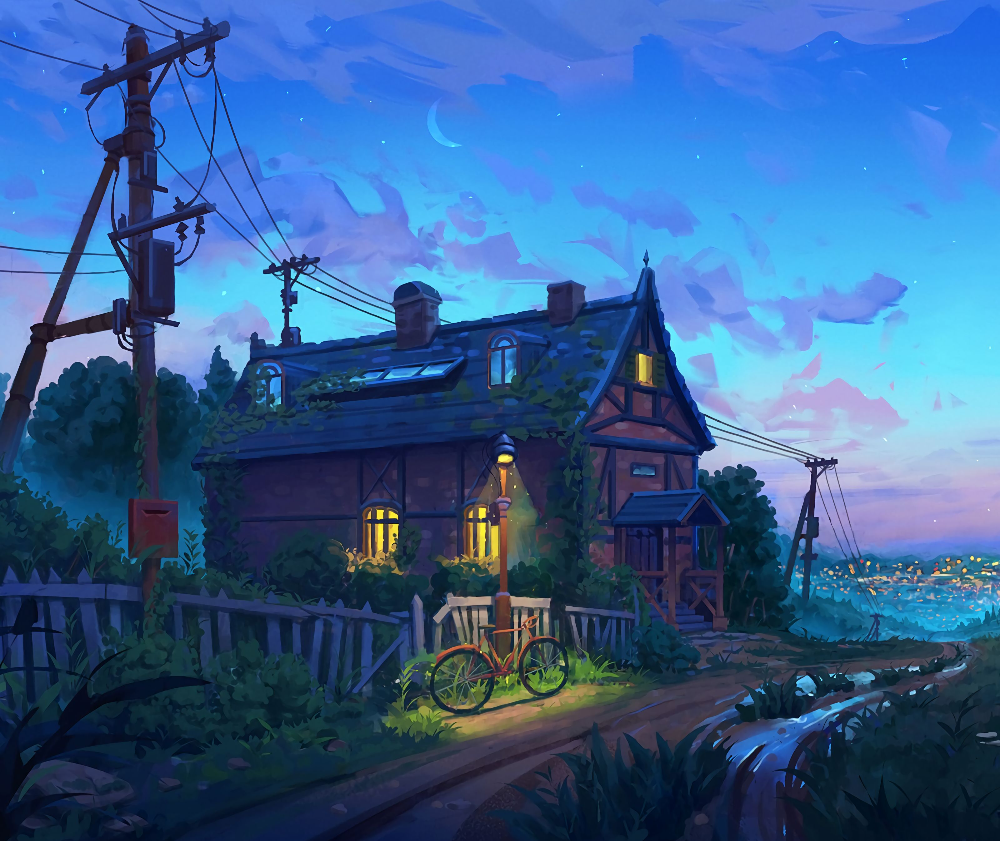

In [3]:
# Step 3: Read the uploaded image
filename = list(uploaded.keys())[0]
image = cv2.imread(filename) # OpenCV reads in BGR format
cv2_imshow(image) # Show the original image

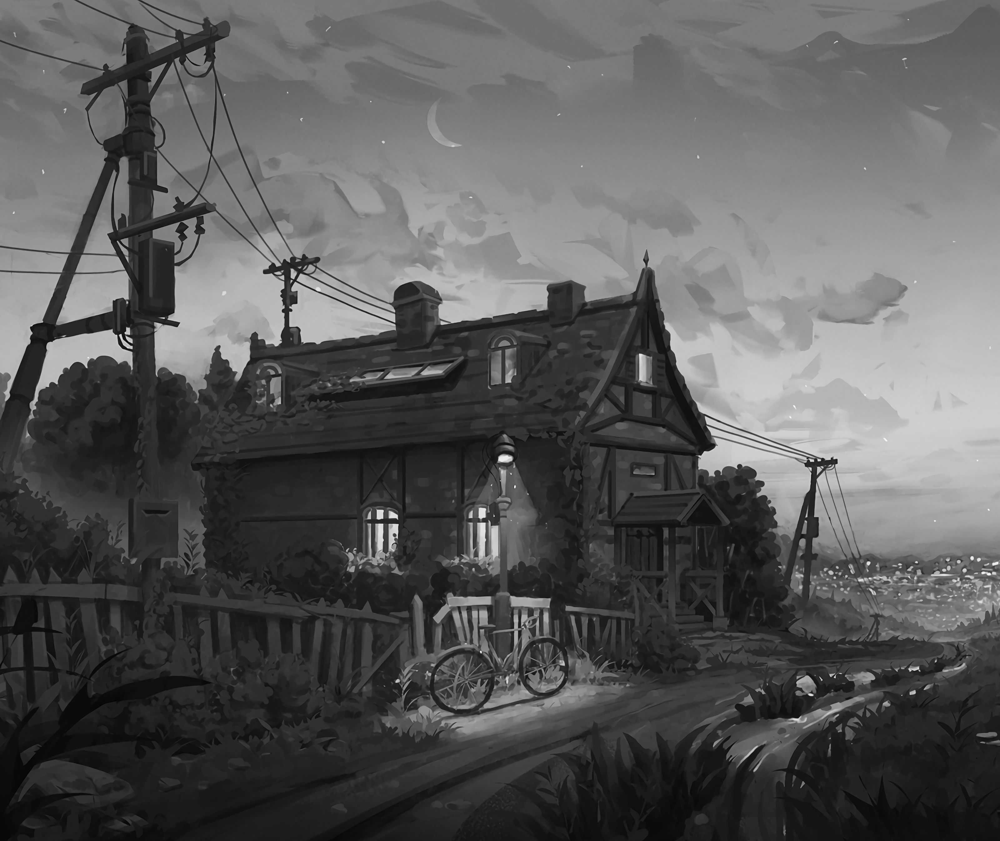

In [4]:
# Step 4: Convert to Grayscale
gray =cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
cv2_imshow(gray)

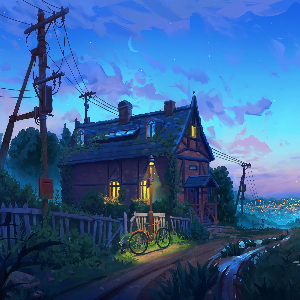

In [5]:
# Step 5: Resize the Image to 300×300
resized = cv2.resize(image,(300, 300))
cv2_imshow(resized)

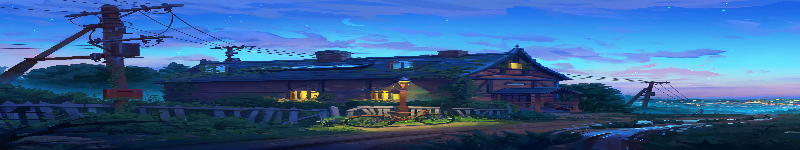

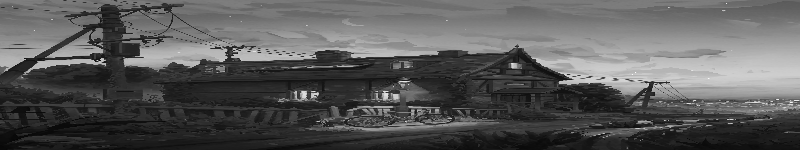

In [6]:
a =[image,gray]
for i in a:
  resized = cv2.resize(i,(800,150))
  cv2_imshow(resized)

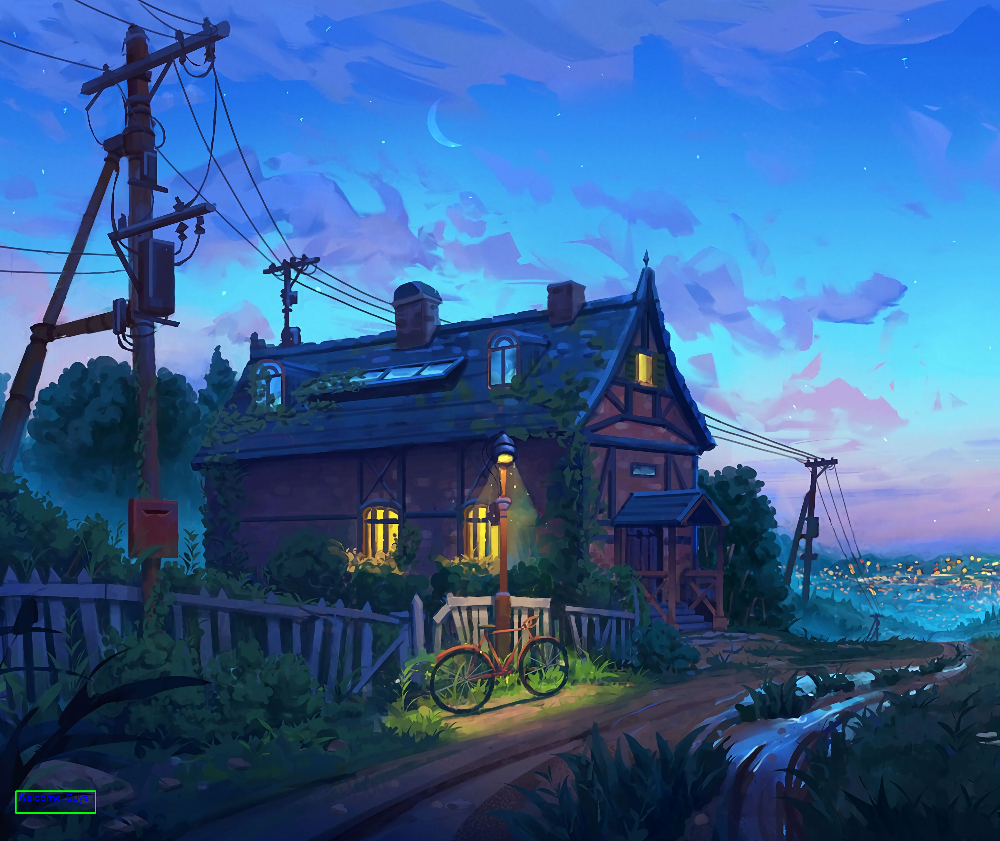

In [7]:
# Step 6: Draw Rectangle and Text
annotated = image.copy()

# Define the bottom-left corner coordinates
bottom_left_x = 50
bottom_left_y = image.shape[0] - 160  # Adjusting for the height of the rectangle

# Draw the rectangle
cv2.rectangle(annotated, (bottom_left_x, bottom_left_y), (bottom_left_x + 255, bottom_left_y + 70), (0, 355, 0), 3)

# Put text inside the rectangle
cv2.putText(annotated, 'Welcome Guys', (bottom_left_x + 10, bottom_left_y + 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2)

# Display the annotated image
cv2_imshow(annotated)

In [8]:
# Step 7: Save the modified image
cv2.imwrite('output_image.jpg', annotated)
print("Image saved as output_image.jpg")

Image saved as output_image.jpg


In [9]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array

In [13]:
# Step 8: Upload Image
uploaded = files.upload()
filename = list(uploaded.keys())[0]

Saving pg.jpg to pg (2).jpg


In [14]:
# Step 9: Load and Prepare Image
img = load_img(filename, target_size=(224, 224))  # Resize image
img_array = img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)

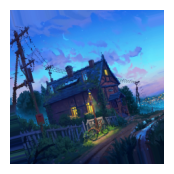

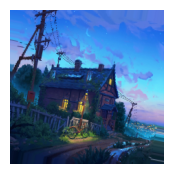

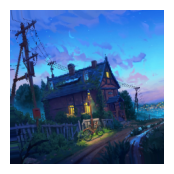

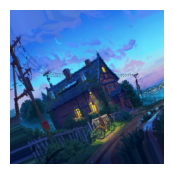

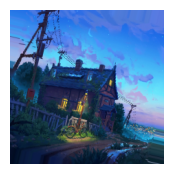

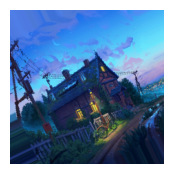

In [15]:
# Step 10:
# Define the augmentation generator
datagen = ImageDataGenerator(
    rotation_range=30,
    # width_shift_range=0.2,
    # height_shift_range=0.2,
    # shear_range=0.2,
    # zoom_range=0.2,
    # horizontal_flip=True,
    # brightness_range=[0.5, 1.5]
)

# Generate augmented images
i = 0
for batch in datagen.flow(img_array, batch_size=1):
    plt.figure(figsize=(2,2))
    plt.imshow(batch[0].astype('uint8'))
    plt.axis('off')
    i += 1
    if i > 5:
        break


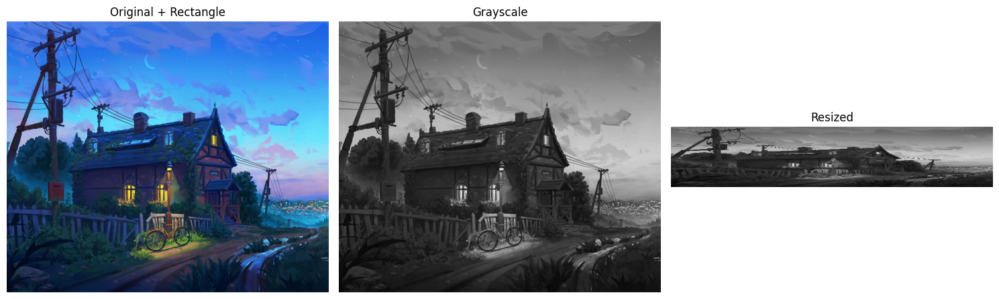

In [16]:
# Step 11: Display images using matplotlib
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

axs[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
axs[0].set_title("Original + Rectangle")

axs[1].imshow(gray, cmap='gray')
axs[1].set_title("Grayscale")

axs[2].imshow(cv2.cvtColor(resized, cv2.COLOR_BGR2RGB))
axs[2].set_title("Resized")

for ax in axs:
    ax.axis("off")

plt.tight_layout()
plt.show()

Summary :

Data Augmentation helps increase dataset size using transformations like:

Flip, Rotate, Zoom

Brightness & Noise

Shear, Shift, Crop

can use:

ImageDataGenerator (TensorFlow/Keras)

Albumentations or imgaug for advanced use-cases